In [2]:
%pip install --upgrade pip
%pip install --upgrade diffusers transformers accelerate peft

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 11.8 MB/s eta 0:00:00
  Attempting uninstall: pip
    Found existing installation: pip 23.1.2
    Uninstalling pip-23.1.2:
      Successfully uninstalled pip-23.1.2
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 44.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 302.6/302.6 kB 26.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 251.6/251.6 kB 22.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 410.6/410.6 MB 3.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.1/14.1 MB 104.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 23.7/23.7 MB 81.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 823.6/823.6 kB 54.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 731.7/731.7 MB 1.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 121.6/121.6 MB 7.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.5/56.5 MB 13

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

The config attributes {'skip_prk_steps': True} were passed to LCMScheduler, but are not expected and will be ignored. Please verify your scheduler_config.json configuration file.


  0%|          | 0/2 [00:00<?, ?it/s]

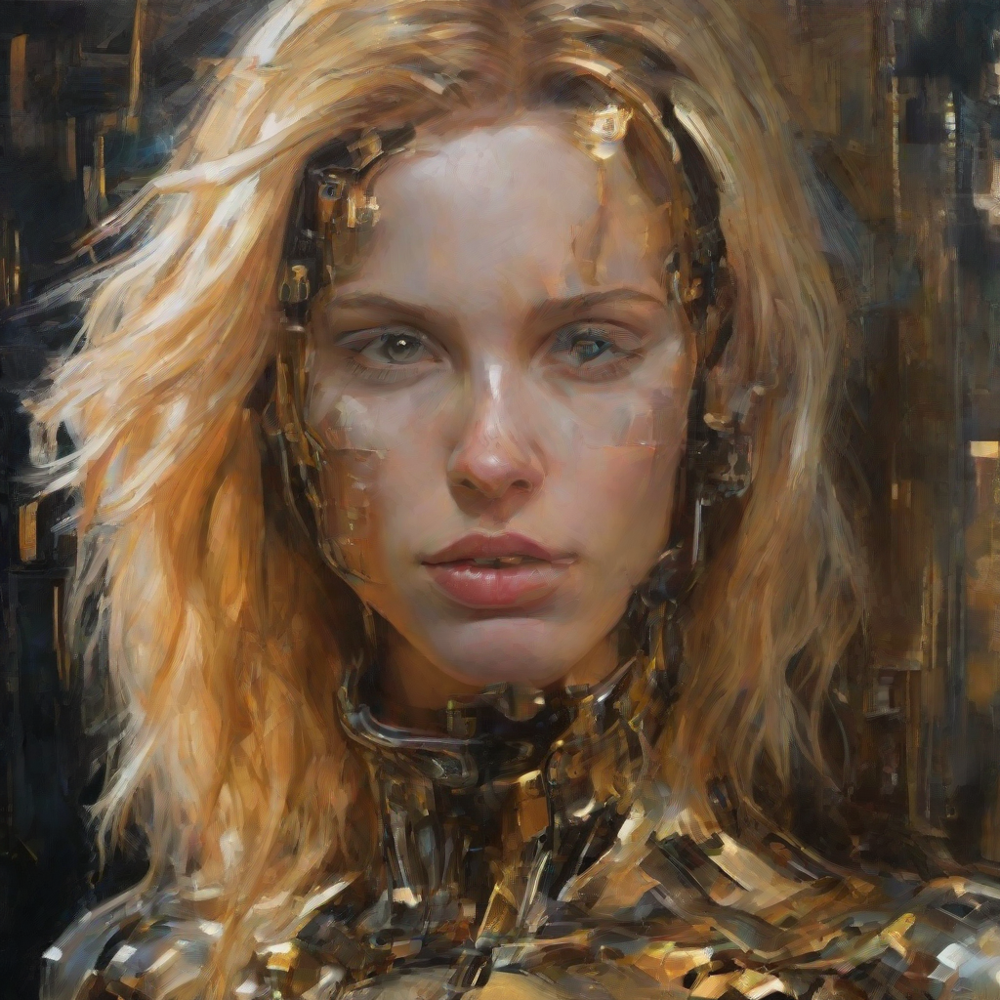

In [3]:
import torch
from diffusers import LCMScheduler, AutoPipelineForText2Image

model_id = "stabilityai/stable-diffusion-xl-base-1.0"
adapter_id = "latent-consistency/lcm-lora-sdxl"

pipe = AutoPipelineForText2Image.from_pretrained(model_id, torch_dtype=torch.float16, variant="fp16")
pipe.scheduler = LCMScheduler.from_config(pipe.scheduler.config)
pipe.to("cuda")

# load and fuse lcm lora
pipe.load_lora_weights(adapter_id)
pipe.fuse_lora()

prompt = "Self-portrait oil painting, a beautiful cyborg with golden hair, 8k"

# disable guidance_scale by passing 0
image = pipe(prompt=prompt, num_inference_steps=2, guidance_scale=0).images[0]
image

In [1]:
import matplotlib.pyplot as plt
def display_images(l,titles=None,fontsize=12):
    n=len(l)
    fig,ax = plt.subplots(1,n)
    for i,im in enumerate(l):
        ax[i].imshow(im)
        ax[i].axis('off')
        if titles is not None:
            ax[i].set_title(titles[i],fontsize=fontsize)
    fig.set_size_inches(fig.get_size_inches()*n)
    plt.tight_layout()
    plt.show()

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

  0%|          | 0/2 [00:00<?, ?it/s]

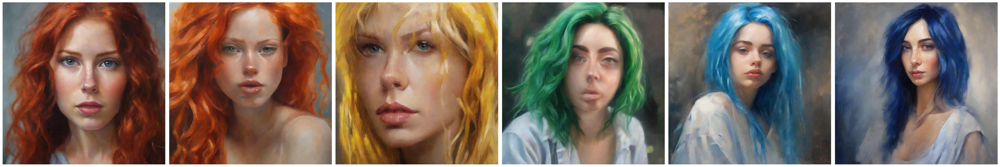

In [5]:
colors = ['red','orange','yellow','green','blue','indigo']
res = []
for c in colors:
  image = pipe(prompt=f"oil painting of a beautiful girl with {c} hair, looking with attention into the camera, 8k", num_inference_steps=2, guidance_scale=0).images[0]
  res.append(image)

display_images(res)

In [7]:
res[-1].save('img.jpg')
ref_image = res[-1]

In [2]:
from PIL import Image
ref_image = Image.open('img.jpg')

In [2]:
import torch
import cv2
import numpy as np
from PIL import Image

from diffusers import StableDiffusionXLControlNetPipeline, ControlNetModel, LCMScheduler
from diffusers.utils import load_image

image = np.array(ref_image)

low_threshold = 100
high_threshold = 200

image = cv2.Canny(image, low_threshold, high_threshold)
image = image[:, :, None]
image = np.concatenate([image, image, image], axis=2)
canny_image = Image.fromarray(image)

controlnet = ControlNetModel.from_pretrained("diffusers/controlnet-canny-sdxl-1.0-small", torch_dtype=torch.float16, variant="fp16")
pipe = StableDiffusionXLControlNetPipeline.from_pretrained(
    "stabilityai/stable-diffusion-xl-base-1.0",
    controlnet=controlnet,
    torch_dtype=torch.float16,
    safety_checker=None,
    variant="fp16"
).to("cuda")

# set scheduler
pipe.scheduler = LCMScheduler.from_config(pipe.scheduler.config)

# load LCM-LoRA
pipe.load_lora_weights("latent-consistency/lcm-lora-sdxl")
pipe.fuse_lora()


/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:88: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Keyword arguments {'safety_checker': None} are not expected by StableDiffusionXLControlNetPipeline and will be ignored.


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

The config attributes {'skip_prk_steps': True} were passed to LCMScheduler, but are not expected and will be ignored. Please verify your scheduler_config.json configuration file.


In [3]:
colors = ['red','orange','yellow','green','blue','indigo']
res = []
for c in colors:
  image = pipe(
      prompt=f"oil painting of a beautiful girl with {c} hair, looking with attention into the camera, 8k",
      image=canny_image,
      num_inference_steps=5,
      guidance_scale=1.5,
      controlnet_conditioning_scale=0.5,
      cross_attention_kwargs={"scale": 1},
      ).images[0]
  res.append(image)

display_images(res)

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

NameError: name 'display_images' is not defined

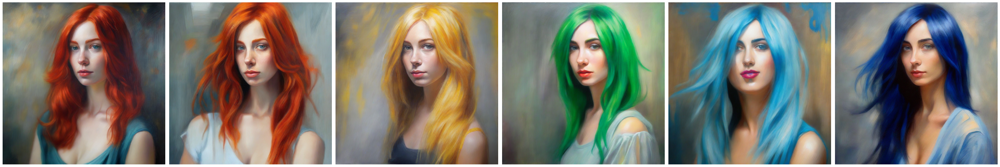

In [5]:
display_images(res)

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

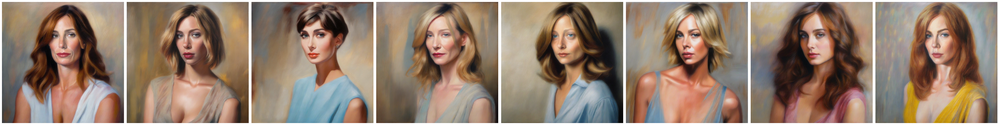

In [8]:
ppl = ['Julia Roberts','Scarlett Johansson', 'Audrey Hepburn', 'Cate Blanchett','Jodie Foster','Charlize Theron','Natalie Portman','Nicole Kidman']
res = []
for c in ppl:
  image = pipe(
      prompt=f"oil painting of a {c}, looking with attention into the camera, 8k",
      image=canny_image,
      num_inference_steps=5,
      guidance_scale=1.5,
      controlnet_conditioning_scale=0.5,
      cross_attention_kwargs={"scale": 1},
      ).images[0]
  res.append(image)

display_images(res)

In [8]:
import imageio.v2 as iio

In [25]:
video = iio.get_reader('vickie_room.mp4', 'ffmpeg')
for x in video:
  print(x.shape)


/usr/lib/python3.10/subprocess.py:1796: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = _posixsubprocess.fork_exec(


(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720, 3)
(1280, 720

unet/diffusion_pytorch_model.safetensors not found


Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion_img2img.StableDiffusionImg2ImgPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


  0%|          | 0/5 [00:00<?, ?it/s]

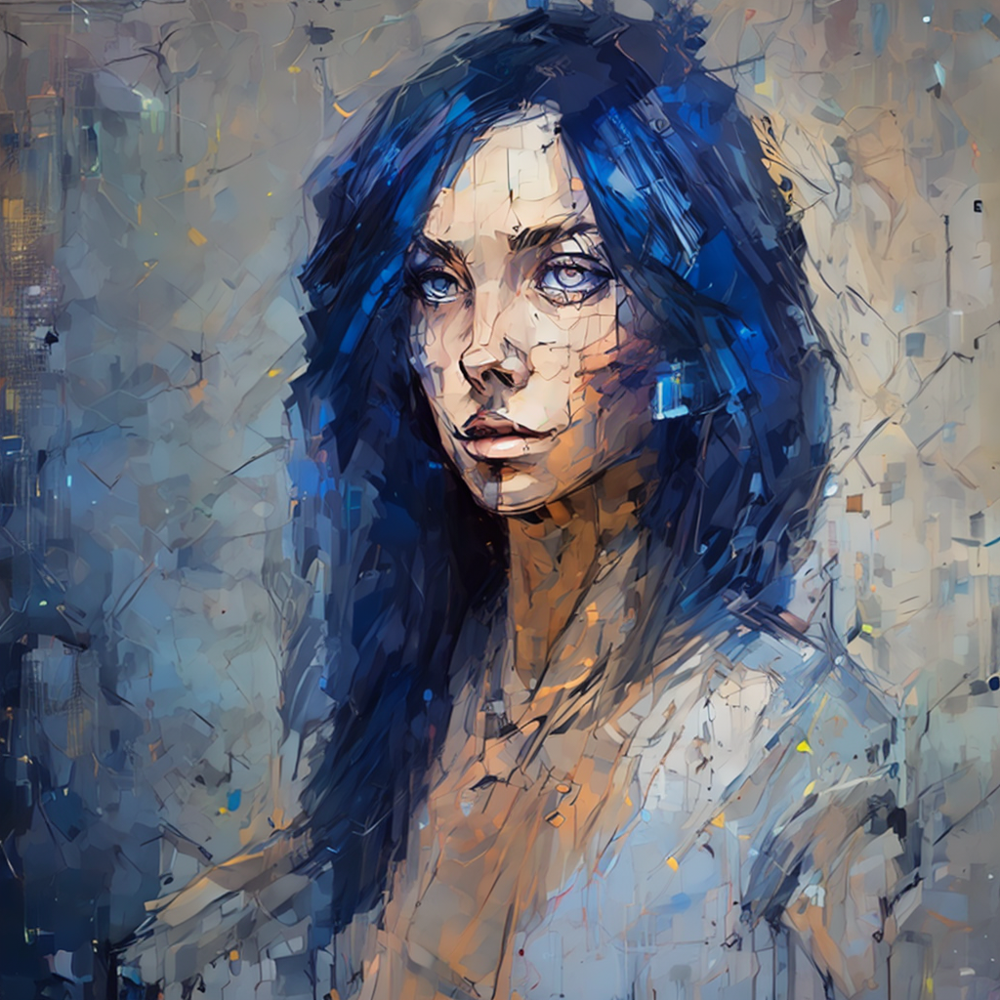

In [17]:
import torch
from diffusers import AutoPipelineForImage2Image

model_id = "Envvi/Inkpunk-Diffusion"

pipe = AutoPipelineForImage2Image.from_pretrained(model_id, torch_dtype=torch.float16, safety_checker=None)
pipe.to("cuda")

prompt = "Self-portrait oil painting, a beautiful cyborg with golden hair, 8k, nvinkpunk"

image = pipe(image=ref_image, strength=0.5, prompt=prompt, num_inference_steps=10, guidance_scale=7.5).images[0]
image

/usr/lib/python3.10/subprocess.py:1796: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = _posixsubprocess.fork_exec(


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

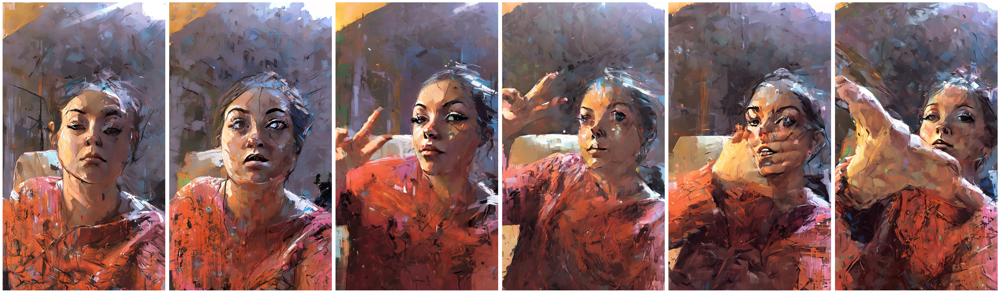

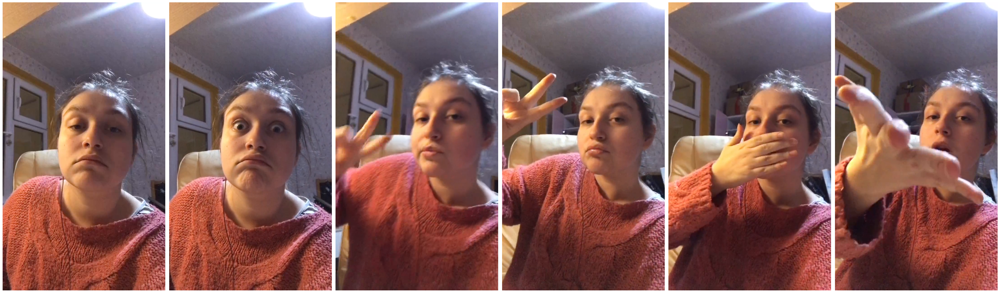

In [22]:
import numpy as np

video = iio.get_reader('vickie_room.mp4', 'ffmpeg')
prompt = "Self-portrait oil painting of a business woman, 8k, nvinkpunk"
res = []
fms = []
for i,x in enumerate(video):
  if i%30==0:
    fms.append(x.astype(np.float32)/255)
    image = pipe(image=x.astype(np.float32)/255, strength=0.5, prompt=prompt, num_inference_steps=10, guidance_scale=7.5).images[0]
    res.append(image)

display_images(res)
display_images(fms)

In [ ]:
video = iio.get_reader('vickie_room.mp4', 'ffmpeg', fps=15)
out = iio.get_writer('vickie_room_sd.mp4', 'ffmpeg', fps=15)
prompt = "Self-portrait oil painting of a business woman, 8k, nvinkpunk"
for i,x in enumerate(video):
  fms.append(x.astype(np.float32)/255)
  image = pipe(image=x.astype(np.float32)/255, strength=0.5, prompt=prompt, num_inference_steps=10, guidance_scale=7.5).images[0]
  out.append_data(np.array(image))

out.close()

/usr/lib/python3.10/subprocess.py:1796: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = _posixsubprocess.fork_exec(


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]